### Objective: To train models with PCA and with normalization of rows and no intercept. 

In these experiments, I train models using PCA and normalization as a preprocessing method independently. In this I am not using one hot encoding for intercepts. 

In [10]:
import mlflow
from mlflow.models import infer_signature

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from developability import data as data_


from sklearn.decomposition import PCA
from tqdm.notebook import tqdm
import tempfile
from dill import dump, load

from developability.utils import ls
from developability.modeling import  *
from developability.model_pipelines import make_pca_pipeline, make_normalize_transformer_pipeline

## retina display
%config InlineBackend.figure_format = 'retina'
pd.set_option('display.max_rows', 999)
pd.set_option('display.max_columns', 999)

import warnings
warnings.filterwarnings("ignore")
# paths 

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


### Load the data 

In [11]:
data_path = Path(data_.__path__[0])
training_path = data_path / 'train'
data = pd.read_parquet(training_path/'Therapeutic_and_internal_antibodies.parquet')
data.head()

,HeparinRRT,Project,HCDR1_APBS_pos,HCDR1_APBS_neg,HCDR1_APBS_net,HCDR2_APBS_pos,HCDR2_APBS_neg,HCDR2_APBS_net,HCDR3_APBS_pos,HCDR3_APBS_neg,HCDR3_APBS_net,HFR1_APBS_pos,HFR1_APBS_neg,HFR1_APBS_net,HFR2_APBS_pos,HFR2_APBS_neg,HFR2_APBS_net,HFR3_APBS_pos,HFR3_APBS_neg,HFR3_APBS_net,HFR4_APBS_pos,HFR4_APBS_neg,HFR4_APBS_net,LCDR1_APBS_pos,LCDR1_APBS_neg,LCDR1_APBS_net,LCDR2_APBS_pos,LCDR2_APBS_neg,LCDR2_APBS_net,LCDR3_APBS_pos,LCDR3_APBS_neg,LCDR3_APBS_net,LFR1_APBS_pos,LFR1_APBS_neg,LFR1_APBS_net,LFR2_APBS_pos,LFR2_APBS_neg,LFR2_APBS_net,LFR3_APBS_pos,LFR3_APBS_neg,LFR3_APBS_net,LFR4_APBS_pos,LFR4_APBS_neg,LFR4_APBS_net,HCDR_APBS_pos,HCDR_APBS_neg,HCDR_APBS_net,LCDR_APBS_pos,LCDR_APBS_neg,LCDR_APBS_net,HFR_APBS_pos,HFR_APBS_neg,HFR_APBS_net,LFR_APBS_pos,LFR_APBS_neg,LFR_APBS_net,HC_APBS_pos,HC_APBS_neg,HC_APBS_net,LC_APBS_pos,LC_APBS_neg,LC_APBS_net,TOTAL_CDR_APBS_pos,TOTAL_CDR_APBS_neg,TOTAL_CDR_APBS_net,TOTAL_FR_APBS_pos,TOTAL_FR_APBS_neg,TOTAL_FR_APBS_net,TOTAL_APBS_pos,TOTAL_APBS_neg,TOTAL_APBS_net
antibody,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
adalimumab,0.79,Therapeutic,361.422343,-794.503791,-433.081449,1555.624126,-4014.715450,-2459.091324,2875.086488,-138.003294,2737.083194,5376.458039,-1771.257720,3605.200319,2726.475633,-584.411432,2142.064200,3398.963679,-1368.871898,2030.091781,905.524940,-973.487817,-67.962877,7088.950311,-2.623292,7086.327019,1842.767512,0.000000,1842.767512,3232.607354,-34.553594,3198.053760,5204.403827,-935.352752,4269.051075,6533.142402,-21.319271,6511.823132,6140.552634,-104.698825,6035.853809,1542.070672,-1031.505891,510.564781,4792.132957,-4947.222536,-155.089579,12164.325177,-37.176886,12127.148291,12407.422291,-4698.028867,7709.393424,19420.169535,-2092.876739,17327.292796,17199.555248,-9645.251403,7554.303845,31584.494712,-2130.053625,29454.441087,16956.458134,-4984.399421,11972.058712,31827.591826,-6790.905606,25036.686220,48784.049960,-11775.305027,37008.744932
daclizumab,0.84,Therapeutic,4252.553904,0.000000,4252.553904,4452.876492,-904.794295,3548.082197,3911.936888,0.000000,3911.936888,14311.015341,-193.586163,14117.429178,1868.888108,-38.688851,1830.199256,4672.451210,-414.558541,4257.892669,1996.455362,-125.736264,1870.719098,2912.056050,-214.503158,2697.552891,2848.982419,0.000000,2848.982419,6021.840255,0.000000,6021.840255,3227.953846,-1014.915103,2213.038743,10027.781235,0.000000,10027.781235,8142.327827,-283.031831,7859.295996,1246.512062,-635.948490,610.563573,12617.367283,-904.794295,11712.572988,11782.878723,-214.503158,11568.375565,22848.810021,-772.569820,22076.240201,22644.574971,-1933.895424,20710.679547,35466.177304,-1677.364115,33788.813190,34427.453694,-2148.398582,32279.055112,24400.246007,-1119.297454,23280.948553,45493.384992,-2706.465243,42786.919748,69893.630999,-3825.762697,66067.868302
ganitumab,0.79,Therapeutic,1818.147090,0.000000,1818.147090,6910.914448,0.000000,6910.914448,2961.303964,-484.904947,2476.399018,10333.605343,-525.798048,9807.807295,2872.797423,-281.600949,2591.196475,11761.616999,-147.382398,11614.234601,360.371905,-1259.033101,-898.661196,4405.906664,-170.769361,4235.137303,2334.634695,0.000000,2334.634695,1148.865688,-288.326494,860.539194,3364.619614,-1193.814546,2170.805067,620.200783,-1222.838265,-602.637481,3967.226838,-3170.419029,796.807809,1430.429745,-791.895867,638.533878,11690.365502,-484.904947,11205.460556,7889.407047,-459.095855,7430.311192,25328.391670,-2213.814495,23114.577175,9382.476980,-6378.967707,3003.509273,37018.757173,-2698.719442,34320.037731,17271.884027,-6838.063562,10433.820465,19579.772550,-944.000802,18635.771748,34710.868651,-8592.782203,26118.086448,54290.641200,-9536.783004,44753.858196
vedolizumab,0.54,Therapeutic,0.000000,-2649.100853,-2649.100853,4492.540426,-5860.854936,-1368.314511,0.000000,-6989.631169,-6989.631169,6391.205916,-986.398297,5404.807619,3360.681228,0.000000,3360.681228,3163.553567,-2239.208472,924.345095,306.504321,-1241.789054,-935.284733,3087.786259,-636.6

### set up feature sets

In [12]:
def has_number(s): 
    for c in s: 
        if c.isdigit():
            return True
        
    return False

columns = data.columns
tracking_uri = 'http://127.0.0.1:5000'

In [13]:
feature_sets = {'positive_regions': [col for col in columns if col.endswith('pos') and has_number(col)],
                'positive_cdr': [col for col in columns if col.endswith('pos') and has_number(col) and 'CDR' in col],
                'net_regions': [col for col in columns if col.endswith('net') and has_number(col)], 
                'all': [col for col in columns if 'APBS' in col]
                }

In [14]:
data.Project.value_counts()

Project
MPK190         179
MPK65          131
MPK176         131
MPK201         130
Therapeutic    128
RSD5           127
FNI9v81         17
Name: count, dtype: int64

### Look at the pca

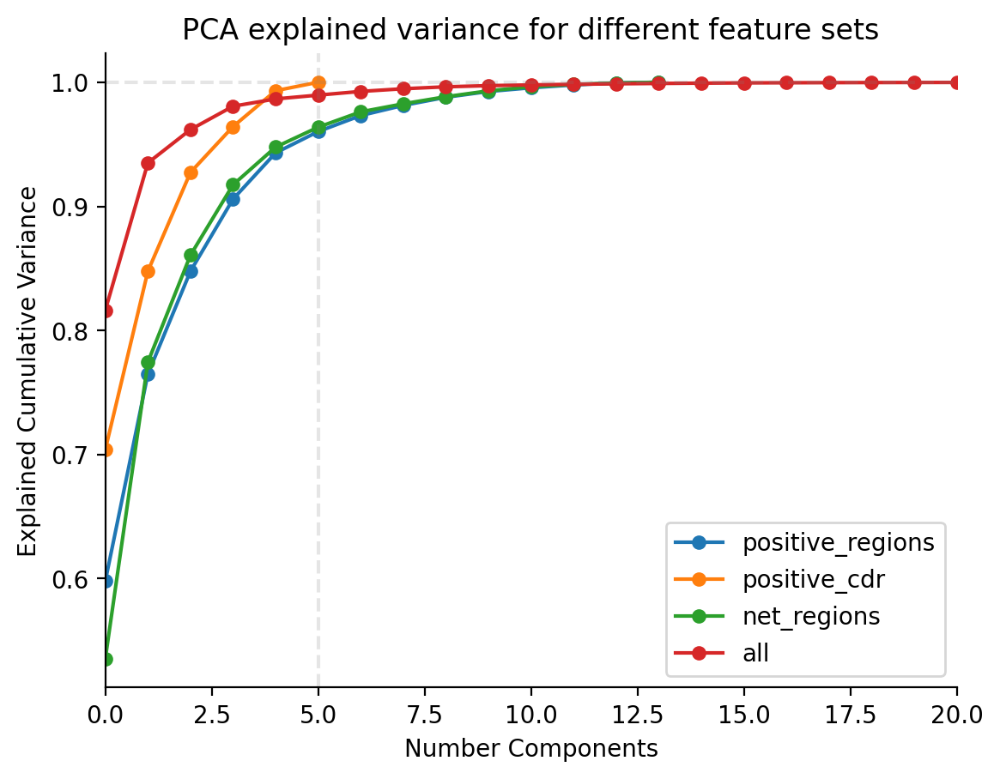

In [6]:
for key in feature_sets:
    pca =PCA()
    X = data[[col for col in feature_sets[key] if col !='Project']]
    pca.fit(X)
    
    variance_ratio = pd.Series(pca.explained_variance_ratio_).cumsum()
    ax = variance_ratio.plot(marker = 'o', ms = 5, xlim = (0,20))
    
ax.set(xlabel = 'Number Components', ylabel ='Explained Cumulative Variance', 
       title='PCA explained variance for different feature sets')
ax.legend(feature_sets.keys())
ax.axvline(5, color = 'grey', linestyle='--', alpha = 0.2)
ax.axhline(1, color = 'grey', linestyle='--', alpha = 0.2)
sns.despine()

### Train 

In [7]:
%%capture
experiment_name = 'RegressionWithPCA_NoIntercept1'
models = ['rf', 'ridge', 'lasso', 'elasticnet']

pipeline_kws = dict(use_intercept=False)

projects = data['Project'].unique()

for project in projects: 
    description = f'PCA models for {project} with no-intercept.'
    train = data.query('Project!=@project')

    exp = MLFlowExperiment(train,
                           target='HeparinRRT', 
                           experiment_name=experiment_name,
                           regression=True, 
                           feature_sets=feature_sets, 
                           tracking_uri=tracking_uri,
                           models=models, 
                           pipeline_func = make_pca_pipeline, 
                           pipeline_kws=pipeline_kws,
                           description=description
                           ) 
    
    exp.train_models();

/home/crivera/miniforge3/envs/surface/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.239e-01, tolerance: 1.604e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/crivera/miniforge3/envs/surface/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.014e-01, tolerance: 1.496e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using

### Train with normalization 

In [8]:
feature_sets = {'positive_regions': [col for col in columns if col.endswith('pos') and has_number(col)] + ['TOTAL_APBS_pos'],
                'positive_cdr': [col for col in columns if col.endswith('pos') and has_number(col) and 'CDR' in col] + ['TOTAL_CDR_APBS_pos'],
                'net_regions': [col for col in columns if col.endswith('net') and has_number(col)] +['TOTAL_APBS_net']
}


In [9]:
%%capture
experiment_name = 'RegressionWithRowNormalization_NoIntercept1'
models = ['rf', 'ridge', 'lasso', 'elasticnet']

pipeline_kws = dict(use_intercept=False)

projects = data['Project'].unique()

for project in projects: 
    description = f'Row Normalization models for {project} with no-intercept.'
    train = data.query('Project!=@project')

    exp = MLFlowExperiment(train,
                           target='HeparinRRT', 
                           experiment_name=experiment_name,
                           regression=True, 
                           feature_sets = feature_sets, 
                           tracking_uri=tracking_uri,
                           models = models, 
                           pipeline_func = make_normalize_transformer_pipeline, 
                           pipeline_kws=pipeline_kws,
                           description=description
                           ) 
    
    exp.train_models();

/home/crivera/miniforge3/envs/surface/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.945e-01, tolerance: 1.496e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/crivera/miniforge3/envs/surface/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.091e-01, tolerance: 1.604e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using

### Comment: 
Above I retrain models with no intercept. 


Train Baseline Models

In [15]:
%%capture

feature_sets = {'positive_regions': [col for col in columns if col.endswith('pos') and has_number(col)],
                'positive_cdr': [col for col in columns if col.endswith('pos') and has_number(col) and 'CDR' in col],
                'net_regions': [col for col in columns if col.endswith('net') and has_number(col)], 
                'all': [col for col in columns if 'APBS' in col]
                }


experiment_name = 'BaselineRegressions1'
models = ['rf', 'ridge', 'lasso', 'elasticnet']

projects = data['Project'].unique()

for project in projects: 
    description = f'Baseline for {project}.'
    train = data.query('Project!=@project')

    exp = MLFlowExperiment(train,
                           target='HeparinRRT', 
                           experiment_name=experiment_name,
                           regression=True, 
                           feature_sets=feature_sets, 
                           tracking_uri=tracking_uri,
                           models=models, 
                           pipeline_func=None, 
                           pipeline_kws=None,
                           description=description
                           ) 
    
    exp.train_models();

/home/crivera/miniforge3/envs/surface/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.507e-01, tolerance: 1.496e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/crivera/miniforge3/envs/surface/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.676e-01, tolerance: 1.604e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using